# Homework 2

## Problem statement overall

After simplicfication, the  equation  of  motion  in  one-dimensional space is given by

$$
\frac{dx}{dt}=-U_x'(x)+\xi
$$

$\xi$ is the white noise satisfying the autocorrelation $\left<\xi(t_1)\xi(t_2)\right>=2\delta(t_1-t_2)$.

## Simulate a random walk

### Theoretical analysis

First, we should transfer this ODE into a difference equation form:

$$
x(t+\Delta t)-x(t)=-U_x'(x(t))\Delta t+\Delta t\xi
$$

where $\Delta t\xi$ denotes $\int_0^{\Delta t}\xi(s)ds$

Since $\xi(t)$ is a markov progress and the autocorrelation $\left<\xi(t_1)\xi(t_2)\right>=2\delta(t_1-t_2)$, so $\Delta t\xi \sim \mathcal N (0,2\Delta t)$, then we program it.

### Programming

First, load denpendency and configure.

In [1]:
# mute logging in jupyter notebook
import Logging
Logging.disable_logging(Logging.Warn)

# load dependency
using Distributions, Plots, StatsPlots

Program the function `randwalk` for random walk simulation.

In [2]:
function randwalk(X₀::Vector{<:Real},T::Real;σ²=2,dUₓ=x->0,Δt=0.1)
    Δtξ = Normal(0,√(σ²*Δt))
    N = length(X₀)
    ts = 0:Δt:T
    M = length(ts)
    X = zeros(N,M)
    for (i,t) in enumerate(ts)
        X[:,i] = t == 0 ? X₀ : X[:,i-1] .+ rand(Δtξ,N) .- dUₓ.(X[:,i-1]).*Δt
    end
    return (ts=ts,X=X)
end

randwalk (generic function with 1 method)

In [3]:
function distanim(ts::AbstractRange,X::Matrix{<:Real};F=10,xbins=:fd,ylim=(0,0.5))
    @gif for (f,(t,Xₜ)) in zip(ts,eachcol(X)) |> enumerate
        (f-1) % F != 0 && continue
        histogram(Xₜ,normalize=:pdf,bins=xbins,label=false)
        title!("Particles distribution at t=$t")
        ylims!(ylim)
        xlabel!("\$X(t=$t)\$")
        ylabel!("Probability Density")
    end
end

distanim (generic function with 1 method)

### Problem A

#### Question statement

For $U(x)=0$,  the  Brownian  particle  undergoes  a  random  walk.  Please  carry  out  the 
simulation to obtain the particle trajectory and compute $\left<[x(t)-x(0)]^2\right>$, which is expected to 
be  linear  in t.  Determine  the  diffusivity  from  the  numerical  data  for $\left<[x(t)-x(0)]^2\right>$ and 
compare it with the theoretical value. 

#### Theoretical Analysis

For $U(x)=0$, the equation of motion turns to this:

$$
\frac{dx}{dt}=\xi
$$

Solve this ode, we get:

$$
x(t)=x(0)+\int_0^t\xi(s)ds
$$

then

$$
\left<[x(t)-x(0)]^2\right>=2t
$$

thus the theoretical value of diffusivity $D=\frac12 \frac{d}{dt}\left<[x(t)-x(0)]^2\right>=1$.

#### Simulation configure

Let number of particles $N=3000$, time duration $T=500$s, time step $\Delta t=0.1$s.

For simplicty, let $x(0)=0$ for all particle.

##### 1. Carry  out  the simulation to obtain the particle trajectory.

In [3]:
ts,X=randwalk(zeros(3000),500;σ²=2);

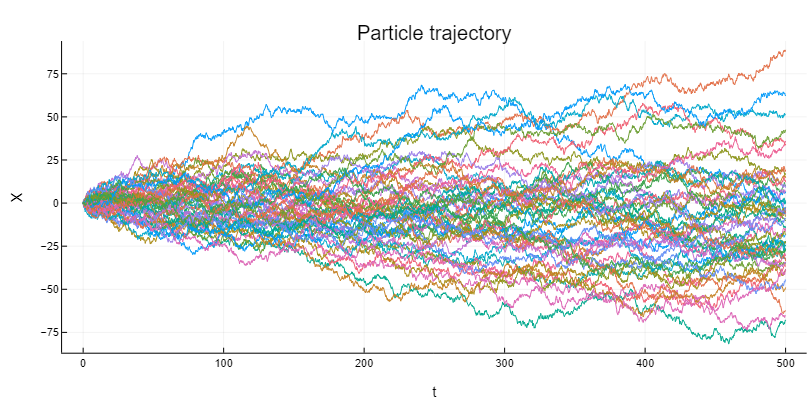

In [7]:
plotly()
plot(ts,X[end,:],label=false)
for i in 1:50
    plot!(ts,X[i,:],label=false)
end
title!("Particle trajectory")
xlabel!("t")
ylabel!("X")

Plots.AnimatedGif("C:\\Users\\CreatorFan\\Documents\\Course\\PostGraduate\\Coursework\\MSDM5003\\Assignment\\HW2\\tmp.gif")
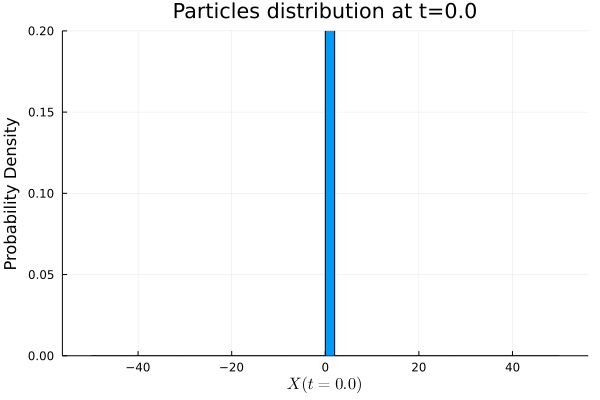

In [5]:
gr();
distanim(0:0.1:150,X;F=10,xbins=-50:2:50,ylim=(0,0.2))

##### 2. Compute $\left<[x(t)-x(0)]^2\right>$

In [6]:
x̄²=mean(X.^2,dims=1)|>vec;

##### 3. Compare it with the theoretical value

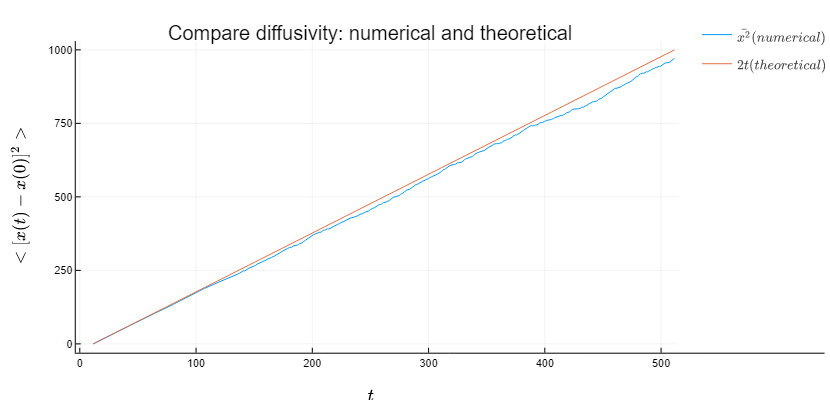

In [7]:
plotly()
plot(ts,x̄²,label=raw"$\bar{x^2}(numerical)$")
plot!(t->2t,label=raw"$2t(theoretical)$")
title!("Compare diffusivity: numerical and theoretical")
xlabel!(raw"$t$")
ylabel!(raw"$<[x(t)-x(0)]^2>$")

From this figure, we can see $\hat{D}$ is quite close to the theoretical value $D$.

### Problem B

#### Question statement

For $U(x)=\frac{x^2}2$ (a  confinement  potential),  please  carry  out  the  simulation  to  find  the 
stationary  probability  density  function  (PDF)$f(x)$ from  long-time  behaviour  of  particle 
trajectory.  Is  your  numerical  PDF  close  to  a  normal  distribution?  What  is  the  value  of  the 
variance of $f(x)$? 

#### Theoretical Analysis

For $U(x)=\frac{x^2}2$, the equation of motion turns to this:

$$
\frac{dx}{dt}=-x+\xi
$$

Solve this ode, we get:

$$
x(t)=x(0)e^{-t}+e^{-t}\int_0^te^s\xi(s)ds
$$

Let's consider $\left<x(t)\right>$, since $<\xi(t)>=0$, then

$$
\left<x(t)\right>=x(0)e^{-t}
$$

when $t\to\infty$,$\left<x(\infty)\right>=0$

Let's consider $\left<x(t)^2\right>$,

$$
\left<x(t)^2\right>=x(0)^2e^{-2t}+(1-e^{-2t})
$$

when $t\to\infty$,$\left<x(\infty)^2\right>=1$

From these, we can get $Var(x(\infty))=1$, we can compare this theoretical result with simulation.

#### Simulation configure

Let number of particles $N=5000$, time duration $T=5000$s and time step $\Delta t=0.1$s.

Let $X(0)\sim \mathcal U(-5,5)$, which means we sample $x(0)$ randomly between $[-5,5]$ for all particles.

##### 1. Carry  out  the  simulation  to  find  the stationary  probability  density  function  (PDF)$f(x)$ from  long-time  behaviour  of  particle trajectory.

In [8]:
ts,X=randwalk(rand(Uniform(-5,5),5000),5000;σ²=2,dUₓ=identity);
Xₜ=X[:,end];

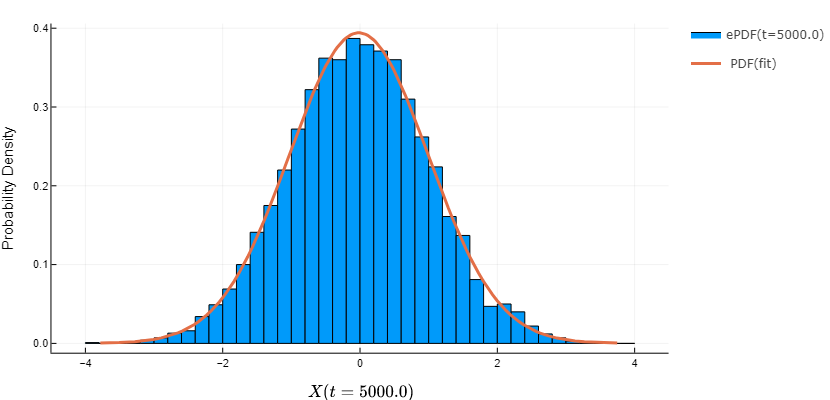

In [9]:
plotly()
histogram(Xₜ,normalize=:pdf,bins=-4:0.2:4,label="ePDF(t=$(ts[end]))")
plot!(fit(Normal,Xₜ),lw=3,label=" PDF(fit)")
xlabel!("\$X(t=$(ts[end]))\$")
ylabel!("Probability Density")

Where ePDF is the statistical sampling plot and PDF is the fitting curve.

##### 2. Determine  my  numerical  PDF  close  to  a  normal  distribution.

From this plot, I think my numerical PDF(ePDF) is quite close to a normal distribution.

##### 3. Compute  the  value  of  the variance of $f(x)$.

In [10]:
@show var(Xₜ);

var(Xₜ) = 1.0247106356478068


The value of the variance of my ePDF is quite close to the theoretical result 1.

Plots.AnimatedGif("C:\\Users\\CreatorFan\\Documents\\Course\\PostGraduate\\Coursework\\MSDM5003\\Assignment\\HW2\\tmp.gif")
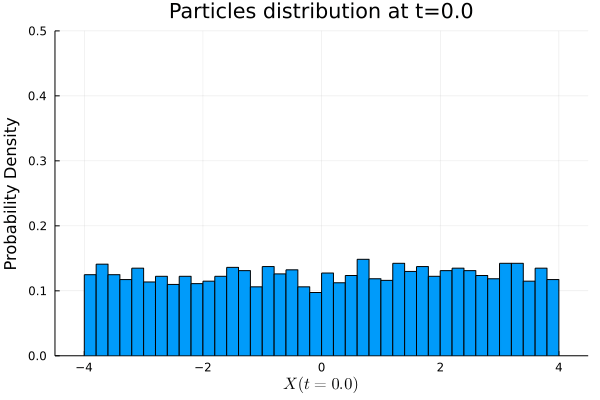

In [11]:
gr();
distanim(0:0.1:12,X;F=1,xbins=-4:0.2:4,ylim=(0,0.5))